In [1]:
from scapy.all import *
import matplotlib.pyplot as plt

# consts
PCAP_PATH = "weekday.pcap"

In [2]:
# Read the pcap file
packets = rdpcap(PCAP_PATH)

FileNotFoundError: [Errno 2] No such file or directory: 'weekday.pcap'

In [ ]:
import scapy.all as scapy

def find_unique_layers(packets):
    unique_layers = []

    for packet in packets:
        if packet.haslayer(scapy.IP):
            # Extract the layers from the packet
            layers = packet.layers()

            # Add the layer names to the set of unique layers
            for layer in layers:
                unique_layers.append(layer.__name__)

    return unique_layers

# Find the unique layers in the packets
unique_layers = set(find_unique_layers(packets))

# Print the unique layers
print("Unique Layers in the IPv4 Packets:")
for layer in unique_layers:
    print(layer)

Unique Layers in the IPv4 Packets:
TCP
Ether
ICMP
IP
DNS
NTPHeader
Raw
Padding
UDP


In [13]:
def extract_headers(pcap_file):
    packets = scapy.rdpcap(pcap_file)

    for packet in packets:

        if packet.haslayer(scapy.IP):

            ip_header = packet[scapy.IP].copy()
            packet[scapy.IP].options = []

            if packet.haslayer(scapy.TCP):
                packet[scapy.TCP].options = []
            if packet.haslayer(scapy.UDP):
                packet[scapy.UDP].options = []
            if packet.haslayer(scapy.ICMP):
                packet[scapy.ICMP].options = []

            # if packet.haslayer(scapy.Raw):
            #     packet[scapy.Raw] = []
            # if packet.haslayer(scapy.Padding):
            #     packet[scapy.Padding] = []

            if packet.haslayer(scapy.NTPHeader):
                packet[scapy.NTPHeader] = []
            if packet.haslayer(scapy.DNS):
                packet[scapy.DNS] = []

            packet.show()
        
        else:
            continue

if __name__ == "__main__":
    extract_headers(PCAP_PATH)

###[ Ethernet ]### 
  dst       = bc:0f:9a:77:f1:74
  src       = d4:f5:47:2c:91:9b
  type      = IPv4
###[ IP ]### 
     version   = 4
     ihl       = 5
     tos       = 0x0
     len       = 40
     id        = 23174
     flags     = DF
     frag      = 0
     ttl       = 64
     proto     = tcp
     chksum    = 0x4d6b
     src       = 192.168.0.121
     dst       = 142.250.66.195
     \options   \
###[ TCP ]### 
        sport     = 34512
        dport     = https
        seq       = 1088748979
        ack       = 1847461036
        dataofs   = 5
        reserved  = 0
        flags     = A
        window    = 8201
        chksum    = 0xc2fe
        urgptr    = 0
        options   = []

###[ Ethernet ]### 
  dst       = d4:f5:47:2c:91:9b
  src       = bc:0f:9a:77:f1:74
  type      = IPv4
###[ IP ]### 
     version   = 4
     ihl       = 5
     tos       = 0x0
     len       = 82
     id        = 26053
     flags     = DF
     frag      = 0
     ttl       = 54
     proto     = udp
    

AttributeError: 'list' object has no attribute 'haslayer'

In [23]:
ip_address = '172.217.167.68'
ip_address_in_bits = []
for byte in ip_address.split('.'):
    ip_address_in_bits.extend(bin(int(byte))[2:].zfill(8))

str(ip_address_in_bits)

"['1', '0', '1', '0', '1', '1', '0', '0', '1', '1', '0', '1', '1', '0', '0', '1', '1', '0', '1', '0', '0', '1', '1', '1', '0', '1', '0', '0', '0', '1', '0', '0']"

In [2]:
# Print packet details
for packet in packets:
    print(packet.summary())
    break

# Perform basic analysis and statistics
total_packets = len(packets)
total_layers = len(set([packet.name for packet in packets]))
total_src_ips = len(set([packet[IP].src for packet in packets if IP in packet]))
total_dst_ips = len(set([packet[IP].dst for packet in packets if IP in packet]))

# Print statistics
print("Total Packets:", total_packets)
print("Total Unique Layers:", total_layers)
print("Total Source IPs:", total_src_ips)
print("Total Destination IPs:", total_dst_ips)


Ether / IP / TCP 192.168.0.121:34512 > 142.250.66.195:https A
Total Packets: 20000
Total Unique Layers: 1
Total Source IPs: 502
Total Destination IPs: 246


Highest Number of Bits in a Packet: 11999


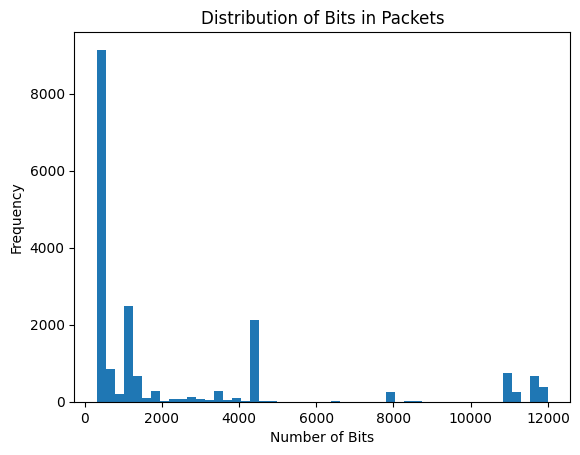

In [7]:


# Initialize the maximum number of bits
max_bits = 0

# Initialize a list to store the number of bits per packet
bits_per_packet = []

# Process each packet
for packet in packets:
    # print(packet.show())
    # break
    if "IP" in packet:
        # Extract the "IP" header
        ip_header = packet["IP"]

        # Convert the IP header to bits
        ip_header_bits = bin(int.from_bytes(bytes(ip_header), byteorder='big'))[2:]

        # Calculate the number of bits in the IP header
        num_bits = len(ip_header_bits)

        # Append the number of bits to the list
        bits_per_packet.append(num_bits)

    # Update the maximum number of bits if necessary
    if num_bits > max_bits:
        max_bits = num_bits

# Print the highest number of bits in a packet
print("Highest Number of Bits in a Packet:", max_bits)

# Plot the histogram
plt.hist(bits_per_packet, bins='auto')
plt.xlabel('Number of Bits')
plt.ylabel('Frequency')
plt.title('Distribution of Bits in Packets')
plt.show()

In [2]:
from scapy.all import rdpcap, wrpcap

# Path to the original pcap file
input_file = "../../data/huge/06-05-2021_weekday.pcap"

# Path to the output pcap file
output_file = "../../data/benign/weekday_06.pcap"

# Number of packets to extract
num_packets = 20000

# Read the original pcap file
packets = rdpcap(input_file)

# Take the first `num_packets` packets
filtered_packets = packets[:num_packets]

# Save the filtered packets to the output pcap file
wrpcap(output_file, filtered_packets)

In [6]:
import scapy.all as scapy

# Load the pcap file
pcap = scapy.rdpcap(PCAP_PATH)

initial_timestamp = 0
set_initial_timestamp = 0

# Iterate through the packets in the pcap file
for packet in pcap:

    # Get the timestamp of the packet
    timestamp = packet.time
    if not set_initial_timestamp:
        initial_timestamp = timestamp
        set_initial_timestamp = 1

    timestamp = timestamp - initial_timestamp
    if timestamp < 0.05:
        print(timestamp)
    else:
        print("Done!!!!")
        set_initial_timestamp = 0

    # Print the timestamp of the packet
    # print(timestamp)

0.000000
0.023026
0.023204
0.024978
0.037531
0.037665
Done!!!!
0.000000
0.004089
0.004885
0.022380
0.032779
Done!!!!
0.000000
0.007249
0.011938
0.017803
0.040320
Done!!!!
0.000000
0.000376
0.012963
Done!!!!
0.000000
0.030367
0.032125
0.032401
Done!!!!
0.000000
0.007321
0.028038
0.045216
Done!!!!
0.000000
0.010548
0.010640
0.011058
0.011946
0.028283
0.028308
Done!!!!
0.000000
0.000004
0.018509
0.018533
0.020339
0.020579
0.020940
0.021050
0.021070
Done!!!!
0.000000
0.000019
0.003368
0.022284
0.023692
0.032369
0.033058
0.048999
0.049257
0.049507
Done!!!!
0.000000
0.001433
0.001470
0.006113
0.007071
0.018204
0.023507
Done!!!!
0.000000
Done!!!!
0.000000
0.001311
0.043174
Done!!!!
0.000000
0.043591
0.043685
0.043710
0.045879
Done!!!!
0.000000
0.007034
0.007977
0.045057
0.045094
0.046646
0.046922
0.046941
0.047239
0.047338
0.047356
Done!!!!
0.000000
0.002520
0.003769
0.003820
0.003843
0.005471
0.005516
0.005538
0.005559
0.020990
0.026950
0.045289
Done!!!!
0.000000
0.002621
0.029628
0.029842
0